# 22k4080 (Bai-7b)

## Medical Image Analysis for Tumor Detection

- Edge Detection for Tumor Identification

Implement edge detection algorithms (Canny, Sobel, or Laplacian) to identify tumor boundaries
Tumors typically appear as masses with distinct edges compared to normal breast tissue
Steps include: preprocessing (noise reduction, contrast enhancement) → edge detection → post-processing (morphological operations) → region analysis

- Additional Feature Extraction Technique

Propose and implement a complementary method such as:

1) Texture analysis (GLCM features) - to capture tissue irregularities
Intensity-based segmentation - to detect abnormal brightness variations
Morphological features - to analyze shape characteristics of suspicious regions
2) Working Mechanism:

Input: Grayscale mammogram images ->
Processing: Multi-stage feature extraction pipeline ->
Output: Annotated images highlighting potential tumor regions with extracted features


originial image


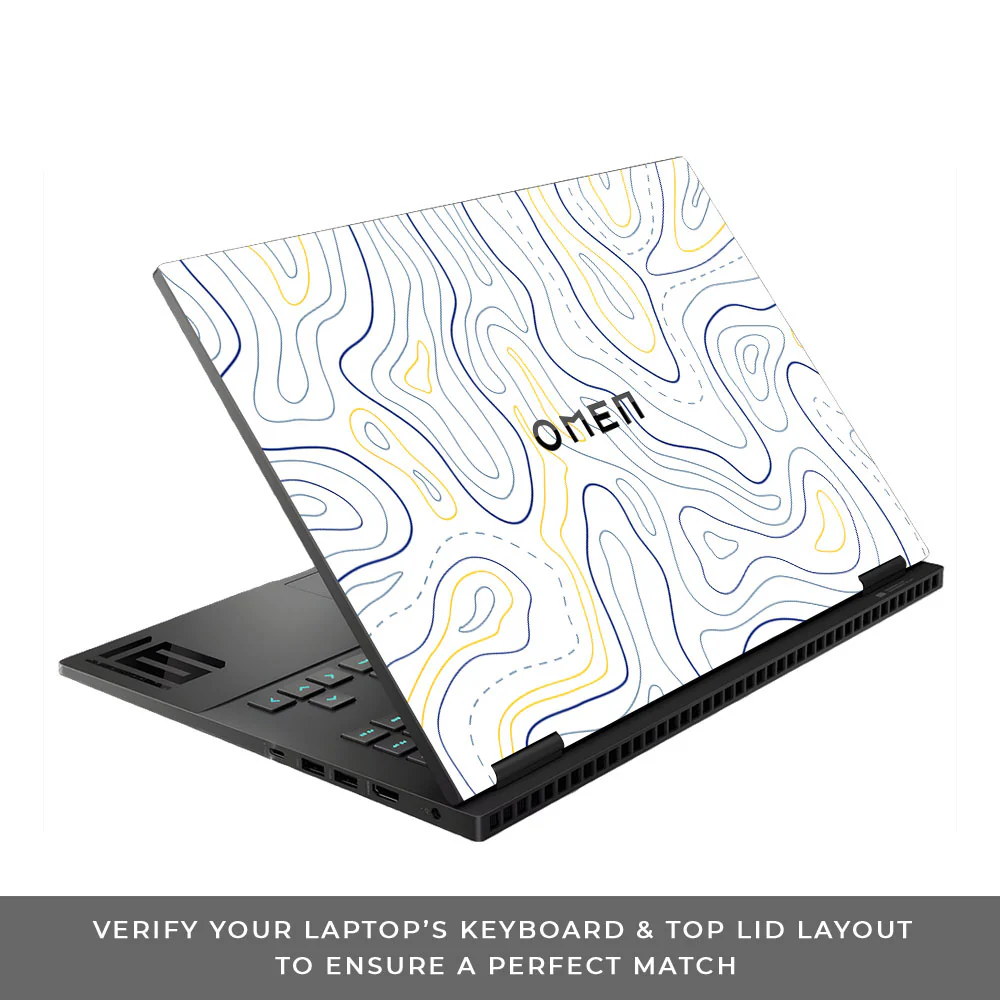

Harris Corners - Threshold 0.01


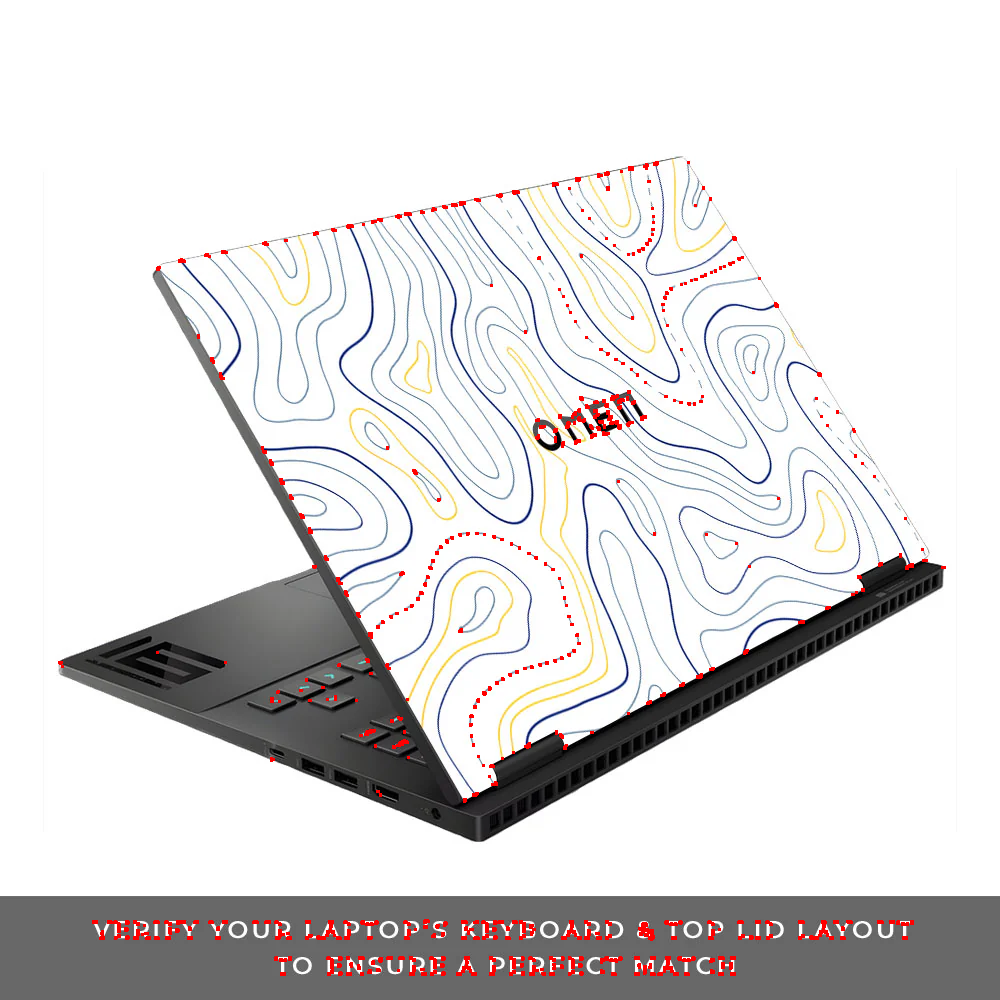

Harris Corners - Threshold 0.05


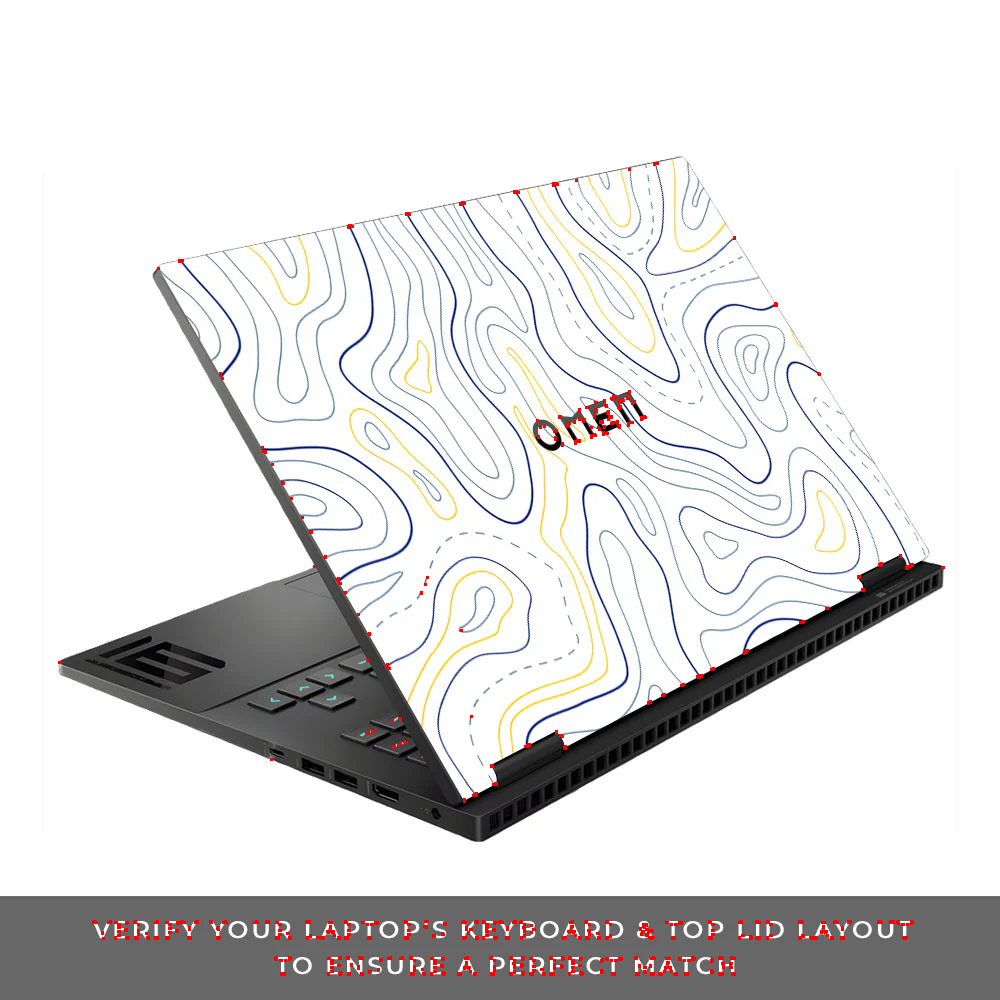

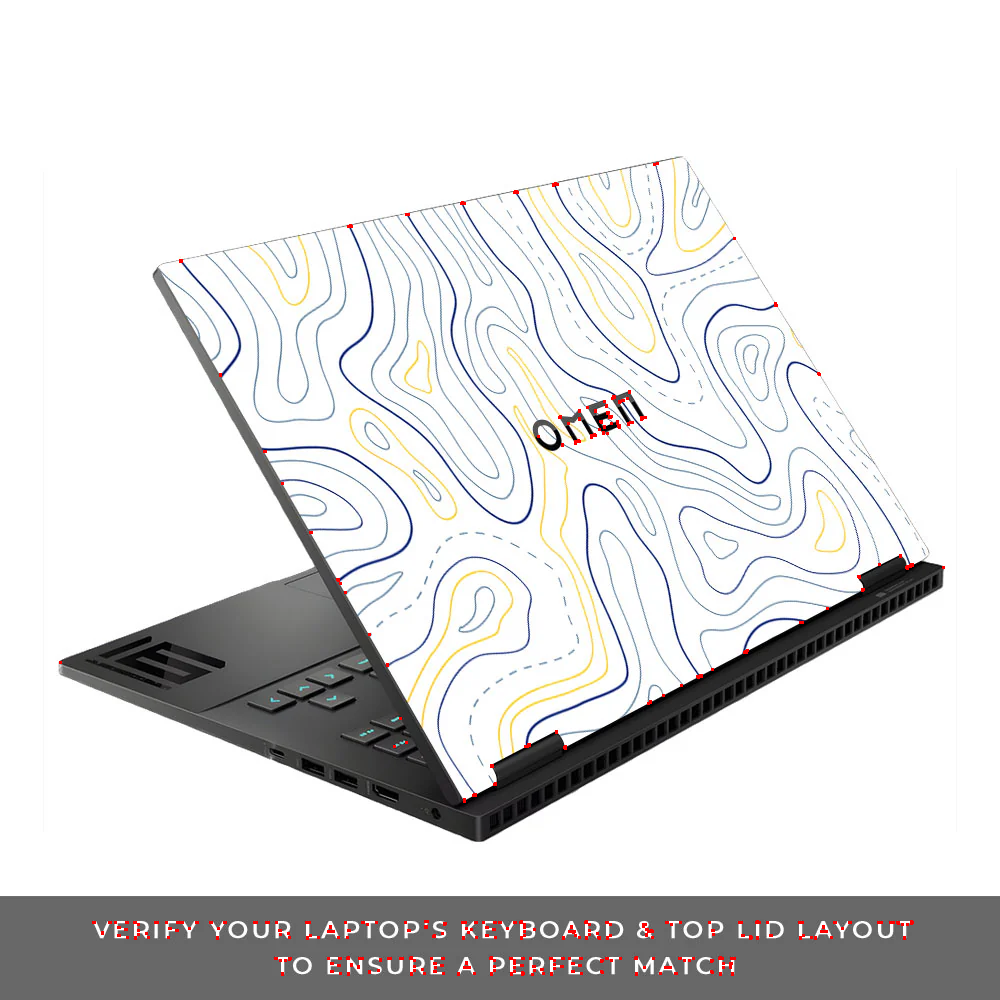

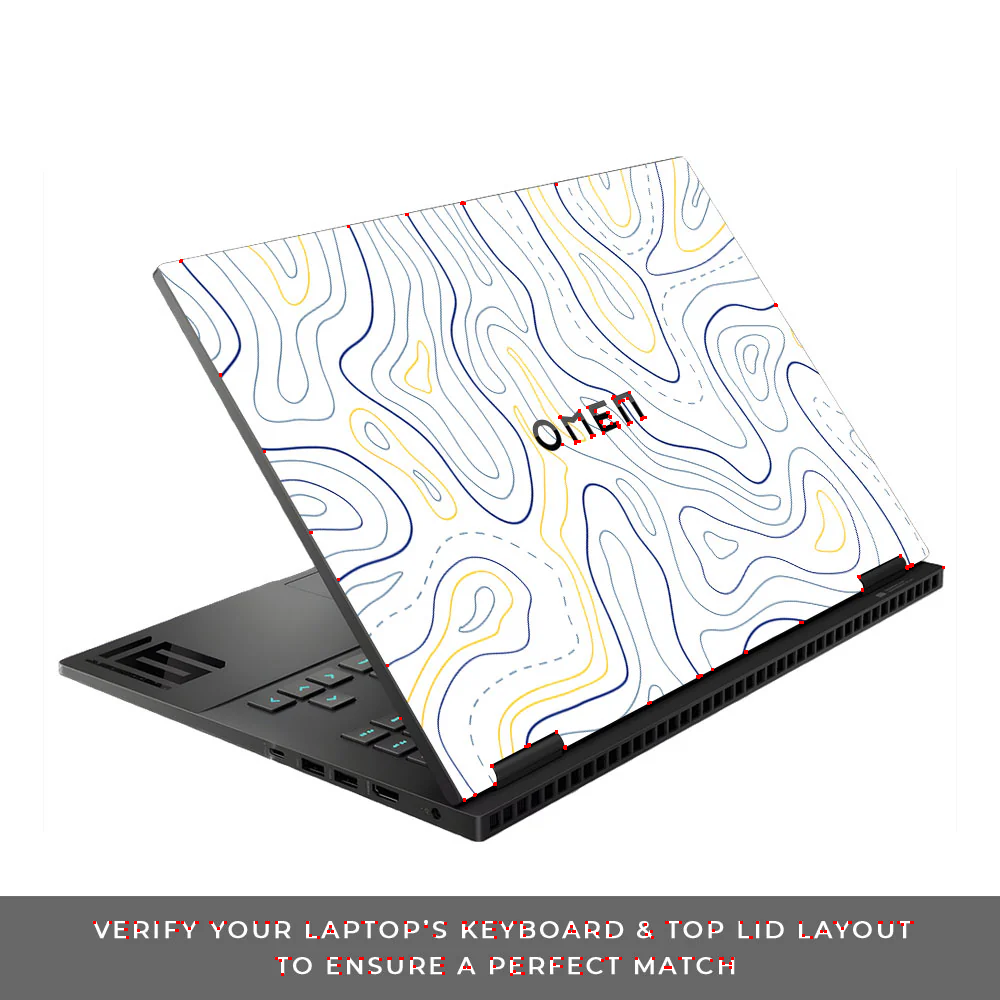

In [5]:
# Lab Task 1
from google.colab.patches import cv2_imshow
import cv2
import numpy as np

img = cv2.imread('/content/top_lid_omen_white.jpg')
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
gray = np.float32(gray)

harris_corners = cv2.cornerHarris(gray, blockSize=2, ksize=3, k=0.04)

harris_corners = cv2.dilate(harris_corners, None)

threshold1 = 0.01 * harris_corners.max()
img1 = img.copy()
img1[harris_corners > threshold1] = [0, 0, 255]

threshold2 = 0.05 * harris_corners.max()
img2 = img.copy()
img2[harris_corners > threshold2] = [0, 0, 255]

threshold3 = 0.1 * harris_corners.max()
img3 = img.copy()
img3[harris_corners > threshold3] = [0, 0, 255]

threshold4 = 0.15 * harris_corners.max()
img4 = img.copy()
img4[harris_corners > threshold4] = [0, 0, 255]

print("originial image")
cv2_imshow(img)
print("Harris Corners - Threshold 0.01")
cv2_imshow(img1)
print("Harris Corners - Threshold 0.05")
cv2_imshow(img2)
cv2_imshow(img3)
cv2_imshow(img4)
cv2.waitKey(0)
cv2.destroyAllWindows()

Capturing image from webcam...


<IPython.core.display.Javascript object>

Image captured!
Shi-Tomasi Corner Detection:


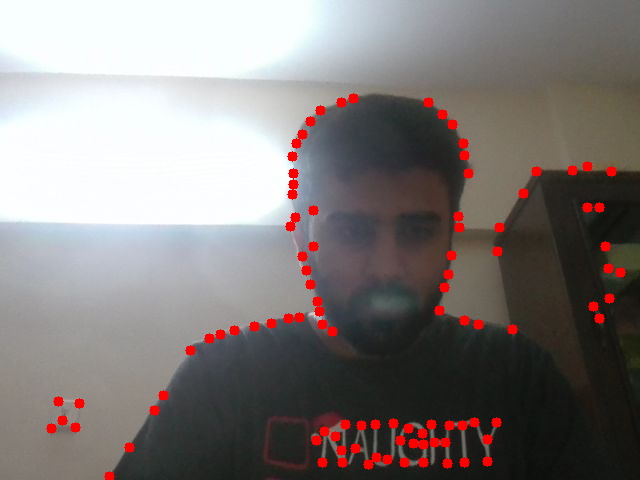


Harris Corner Detection:


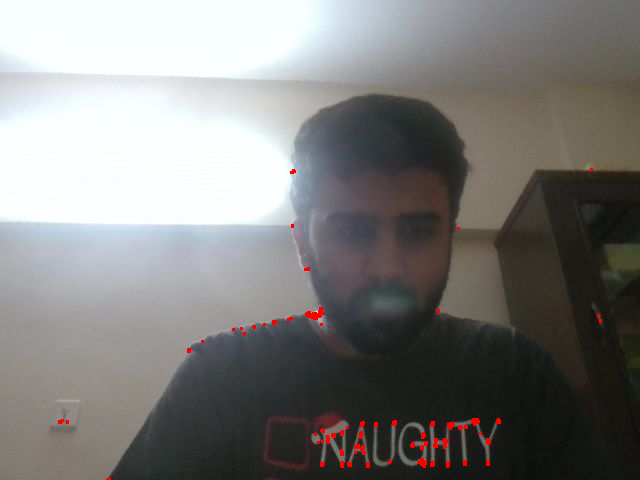


Optimized Shi-Tomasi (High Sensitivity):


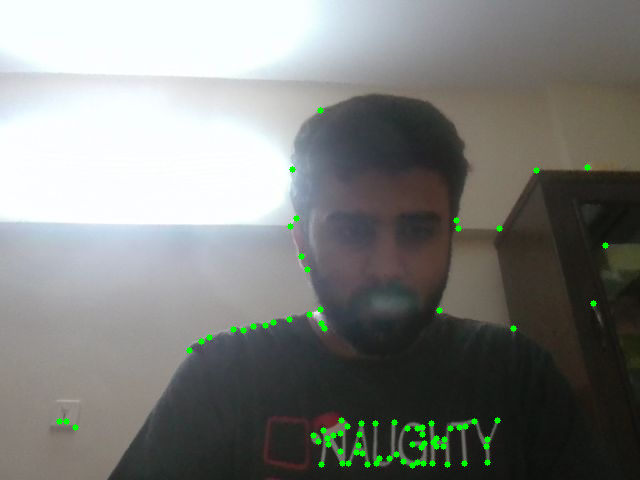


Harris Corner Detection (Adjusted Parameters):


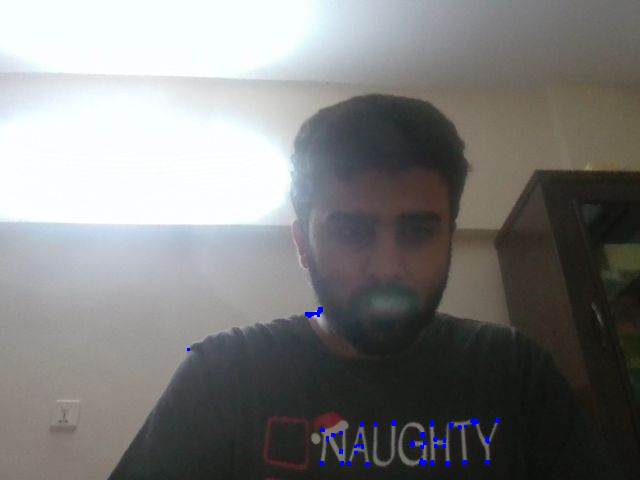

In [11]:
# Lab Task 3:

import cv2
import numpy as np
from google.colab.patches import cv2_imshow
from google.colab import output
from IPython.display import display, Javascript
from google.colab.output import eval_js
from base64 import b64decode
import PIL.Image
import io

def take_photo(filename='photo.jpg', quality=0.8):
    js = Javascript('''
    async function takePhoto(quality) {
      const div = document.createElement('div');
      const capture = document.createElement('button');
      capture.textContent = 'Capture';
      div.appendChild(capture);

      const video = document.createElement('video');
      video.style.display = 'block';
      const stream = await navigator.mediaDevices.getUserMedia({video: true});

      document.body.appendChild(div);
      div.appendChild(video);
      video.srcObject = stream;
      await video.play();

      google.colab.output.setIframeHeight(document.documentElement.scrollHeight, true);

      await new Promise((resolve) => capture.onclick = resolve);

      const canvas = document.createElement('canvas');
      canvas.width = video.videoWidth;
      canvas.height = video.videoHeight;
      canvas.getContext('2d').drawImage(video, 0, 0);
      stream.getVideoTracks()[0].stop();
      div.remove();
      return canvas.toDataURL('image/jpeg', quality);
    }
    ''')
    display(js)
    data = eval_js('takePhoto({})'.format(quality))
    binary = b64decode(data.split(',')[1])
    with open(filename, 'wb') as f:
        f.write(binary)
    return filename

print("Capturing image from webcam...")
filename = take_photo()
print("Image captured!")

img = cv2.imread(filename)
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

corners = cv2.goodFeaturesToTrack(gray, maxCorners=100, qualityLevel=0.01, minDistance=10, blockSize=7)

img_corners = img.copy()
if corners is not None:
    corners = np.int32(corners)
    for corner in corners:
        x, y = corner.ravel()
        cv2.circle(img_corners, (x, y), 5, (0, 0, 255), -1)

print("Shi-Tomasi Corner Detection:")
cv2_imshow(img_corners)

gray_float = np.float32(gray)
harris_corners = cv2.cornerHarris(gray_float, blockSize=2, ksize=3, k=0.04)
harris_corners = cv2.dilate(harris_corners, None)

img_harris = img.copy()
threshold = 0.01 * harris_corners.max()
img_harris[harris_corners > threshold] = [0, 0, 255]

print("\nHarris Corner Detection:")
cv2_imshow(img_harris)

corners2 = cv2.goodFeaturesToTrack(gray, maxCorners=200, qualityLevel=0.05, minDistance=5, blockSize=5)

img_corners2 = img.copy()
if corners2 is not None:
    corners2 = np.int32(corners2)
    for corner in corners2:
        x, y = corner.ravel()
        cv2.circle(img_corners2, (x, y), 3, (0, 255, 0), -1)

print("\nOptimized Shi-Tomasi (High Sensitivity):")
cv2_imshow(img_corners2)

harris_corners2 = cv2.cornerHarris(gray_float, blockSize=3, ksize=5, k=0.06)
harris_corners2 = cv2.dilate(harris_corners2, None)

img_harris2 = img.copy()
threshold2 = 0.05 * harris_corners2.max()
img_harris2[harris_corners2 > threshold2] = [255, 0, 0]

print("\nHarris Corner Detection (Adjusted Parameters):")
cv2_imshow(img_harris2)

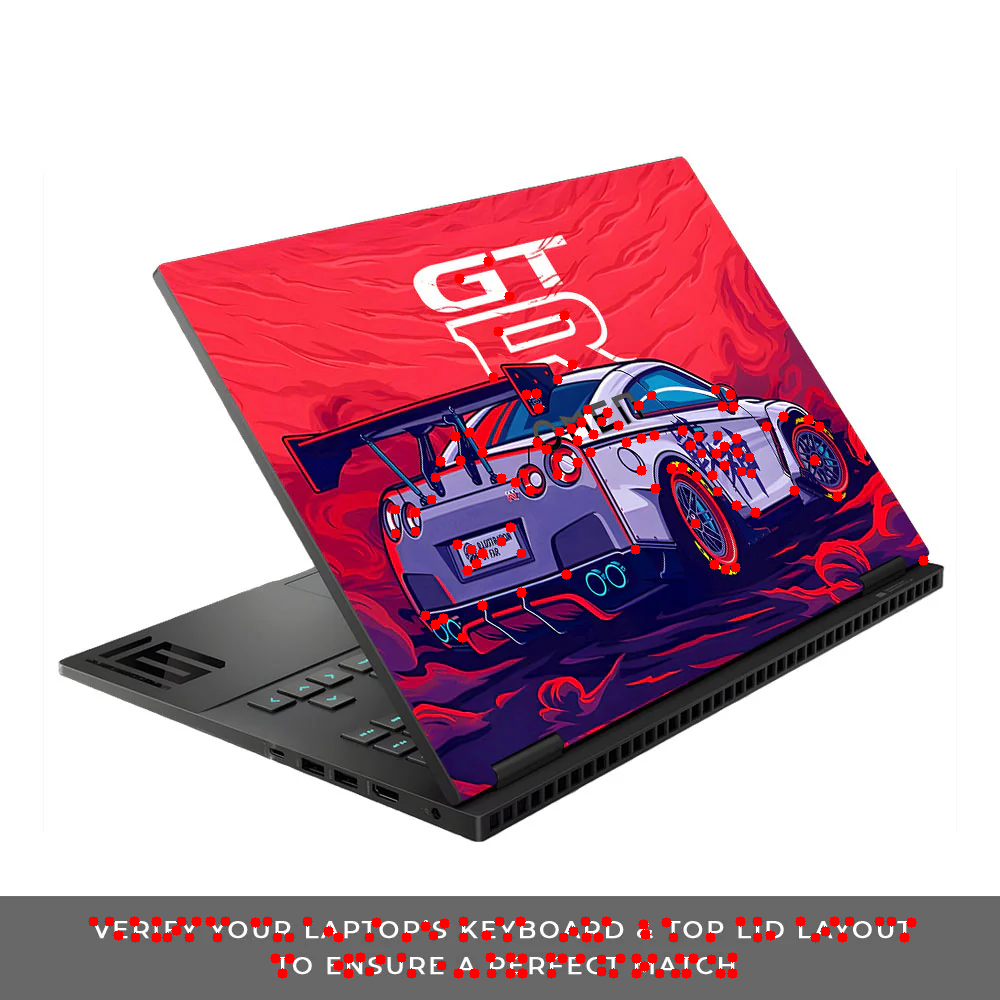

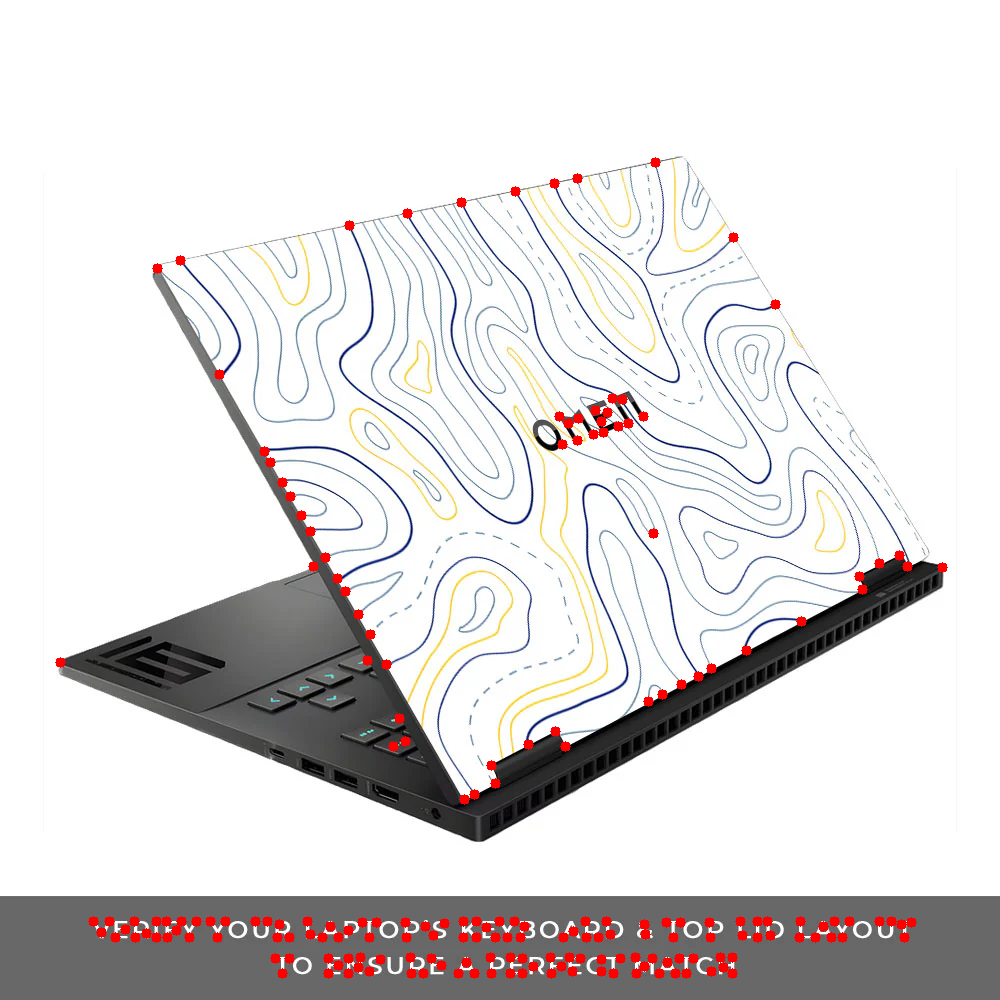

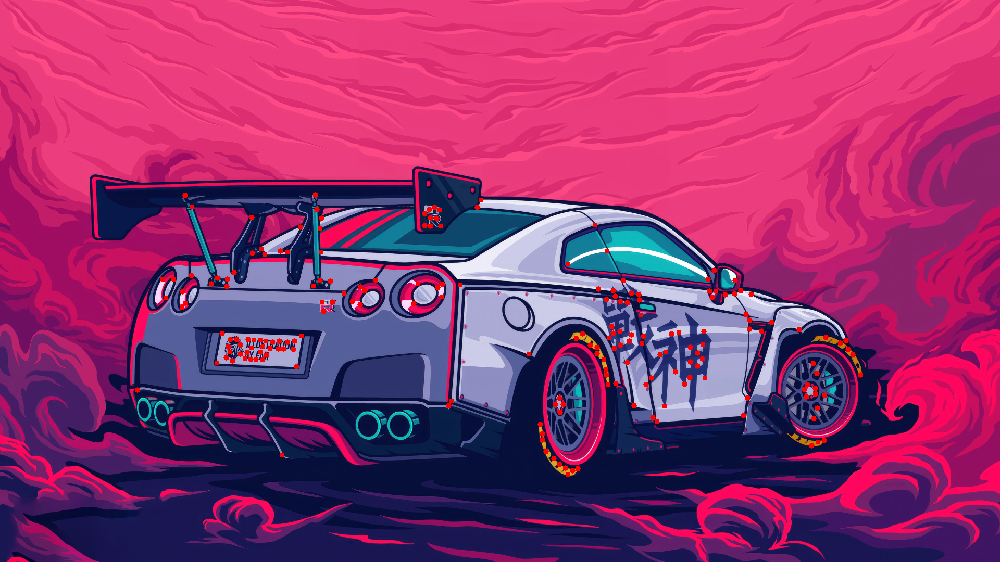

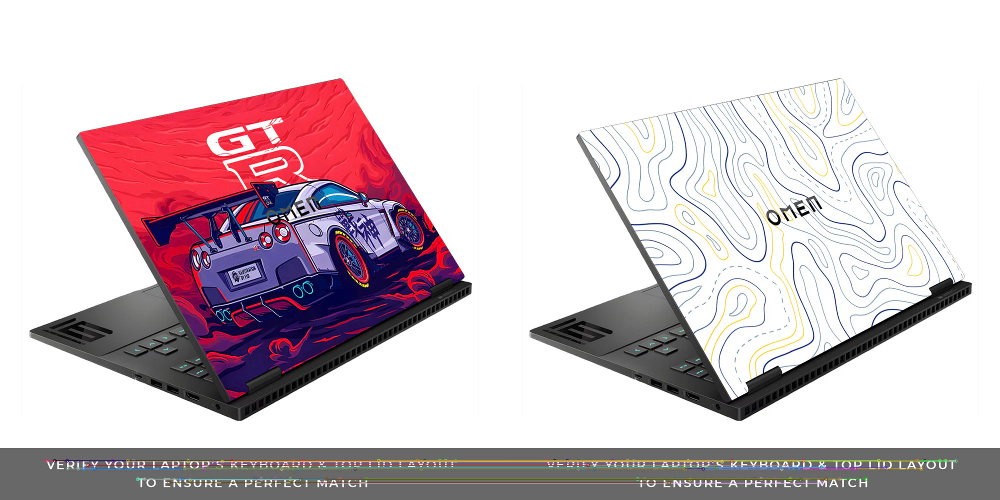

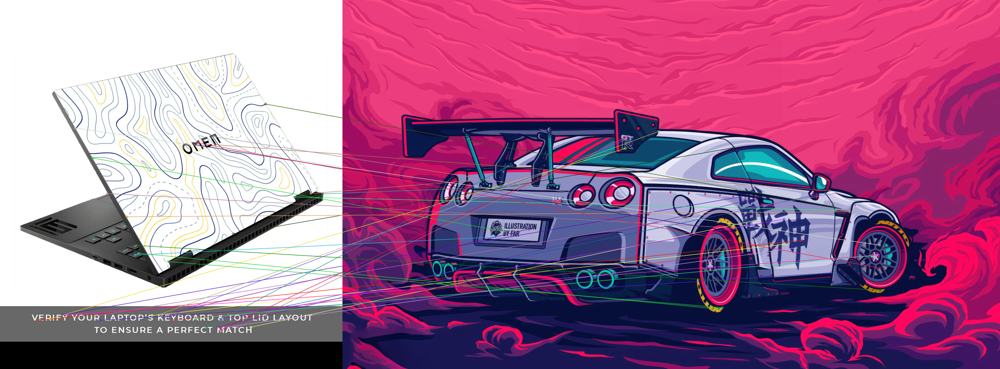

Panorama Result


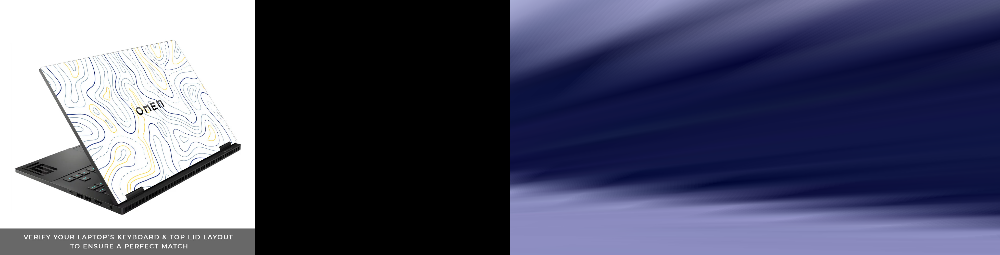

Cropped Panorama


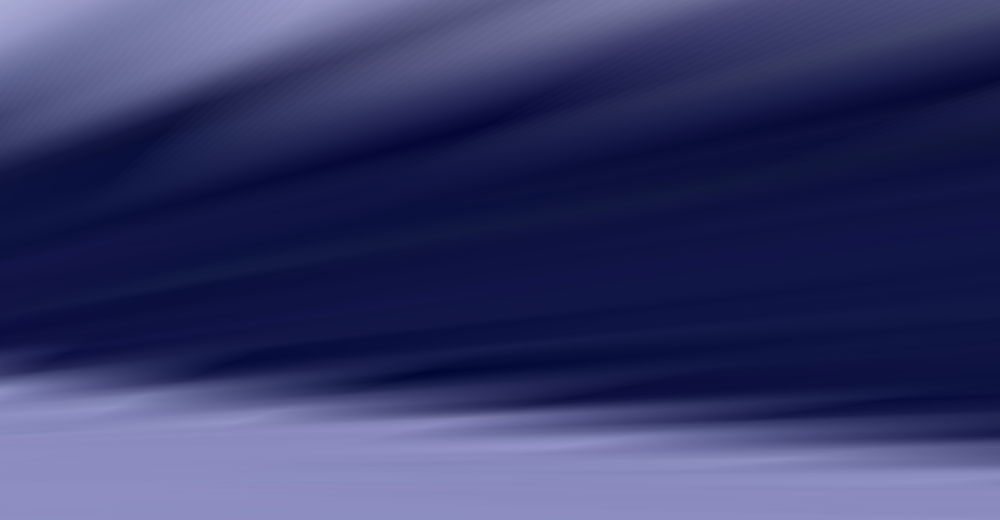

In [18]:
import cv2
import numpy as np

img1 = cv2.imread('/content/Top-Lid_Omen.webp')
img2 = cv2.imread('/content/top_lid_omen_white.jpg')
img3 = cv2.imread('/content/gtr Artisitic Skin.jpg')

gray1 = cv2.cvtColor(img1, cv2.COLOR_BGR2GRAY)
gray2 = cv2.cvtColor(img2, cv2.COLOR_BGR2GRAY)
gray3 = cv2.cvtColor(img3, cv2.COLOR_BGR2GRAY)

corners1 = cv2.goodFeaturesToTrack(gray1, maxCorners=200, qualityLevel=0.01, minDistance=10)
corners2 = cv2.goodFeaturesToTrack(gray2, maxCorners=200, qualityLevel=0.01, minDistance=10)
corners3 = cv2.goodFeaturesToTrack(gray3, maxCorners=200, qualityLevel=0.01, minDistance=10)

img1_corners = img1.copy()
if corners1 is not None:
    corners1 = np.int32(corners1)
    for corner in corners1:
        x, y = corner.ravel()
        cv2.circle(img1_corners, (x, y), 5, (0, 0, 255), -1)

img2_corners = img2.copy()
if corners2 is not None:
    corners2 = np.int32(corners2)
    for corner in corners2:
        x, y = corner.ravel()
        cv2.circle(img2_corners, (x, y), 5, (0, 0, 255), -1)

img3_corners = img3.copy()
if corners3 is not None:
    corners3 = np.int32(corners3)
    for corner in corners3:
        x, y = corner.ravel()
        cv2.circle(img3_corners, (x, y), 5, (0, 0, 255), -1)

cv2_imshow(img1_corners)
cv2_imshow(img2_corners)
cv2_imshow(img3_corners)
cv2.waitKey(0)
cv2.destroyAllWindows()

orb = cv2.ORB_create()

kp1 = [cv2.KeyPoint(x=float(c[0][0]), y=float(c[0][1]), size=20) for c in corners1]
kp2 = [cv2.KeyPoint(x=float(c[0][0]), y=float(c[0][1]), size=20) for c in corners2]
kp3 = [cv2.KeyPoint(x=float(c[0][0]), y=float(c[0][1]), size=20) for c in corners3]

kp1, des1 = orb.compute(gray1, kp1)
kp2, des2 = orb.compute(gray2, kp2)
kp3, des3 = orb.compute(gray3, kp3)

bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True)

matches12 = bf.match(des1, des2)
matches12 = sorted(matches12, key=lambda x: x.distance)

matches23 = bf.match(des2, des3)
matches23 = sorted(matches23, key=lambda x: x.distance)

img_matches12 = cv2.drawMatches(img1, kp1, img2, kp2, matches12[:50], None, flags=2)
img_matches23 = cv2.drawMatches(img2, kp2, img3, kp3, matches23[:50], None, flags=2)

cv2_imshow(img_matches12)
cv2_imshow(img_matches23)
cv2.waitKey(0)
cv2.destroyAllWindows()

src_pts12 = np.float32([kp1[m.queryIdx].pt for m in matches12]).reshape(-1, 1, 2)
dst_pts12 = np.float32([kp2[m.trainIdx].pt for m in matches12]).reshape(-1, 1, 2)

H12, mask12 = cv2.findHomography(src_pts12, dst_pts12, cv2.RANSAC, 5.0)

height1, width1 = img1.shape[:2]
height2, width2 = img2.shape[:2]

result = cv2.warpPerspective(img1, H12, (width1 + width2, height1))
result[0:height2, 0:width2] = img2

src_pts23 = np.float32([kp3[m.trainIdx].pt for m in matches23]).reshape(-1, 1, 2)
dst_pts23 = np.float32([kp2[m.queryIdx].pt for m in matches23]).reshape(-1, 1, 2)

H23, mask23 = cv2.findHomography(src_pts23, dst_pts23, cv2.RANSAC, 5.0)

height3, width3 = img3.shape[:2]
result_height, result_width = result.shape[:2]

final_result = cv2.warpPerspective(img3, H23, (result_width + width3, result_height))
final_result[0:result_height, 0:result_width] = result

print('Panorama Result')
cv2_imshow(final_result)
cv2.waitKey(0)
cv2.destroyAllWindows()

gray = cv2.cvtColor(final_result, cv2.COLOR_BGR2GRAY)
_, thresh = cv2.threshold(gray, 1, 255, cv2.THRESH_BINARY)
contours, _ = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
x, y, w, h = cv2.boundingRect(contours[0])
final_cropped = final_result[y:y+h, x:x+w]

print("Cropped Panorama")
cv2_imshow(final_cropped)
cv2.waitKey(0)
cv2.destroyAllWindows()

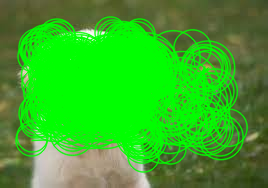

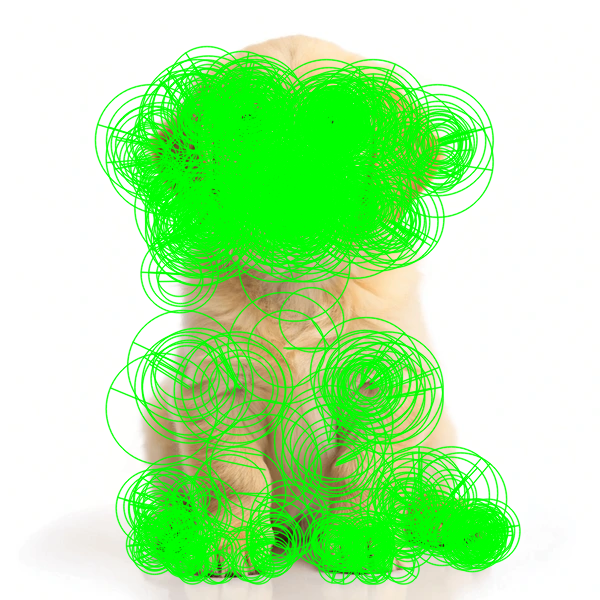

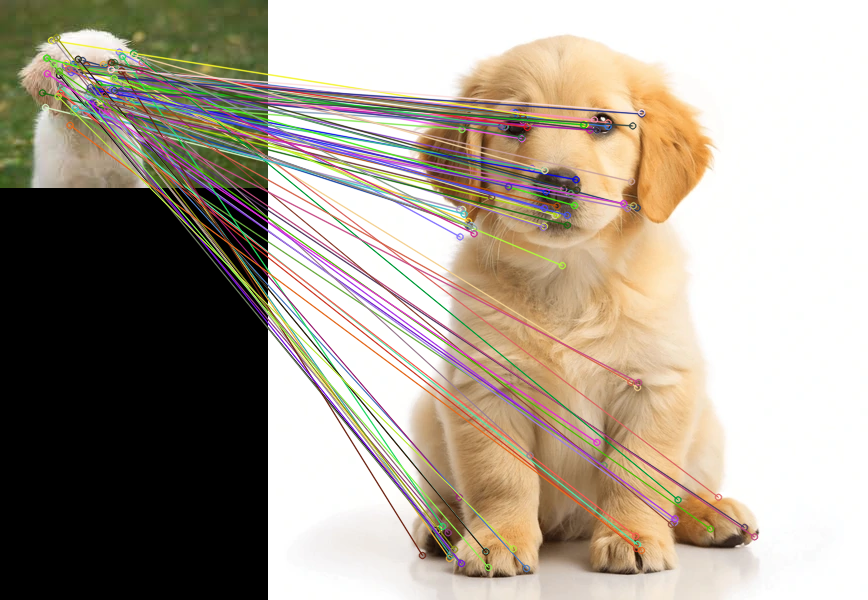

FLANN Matches


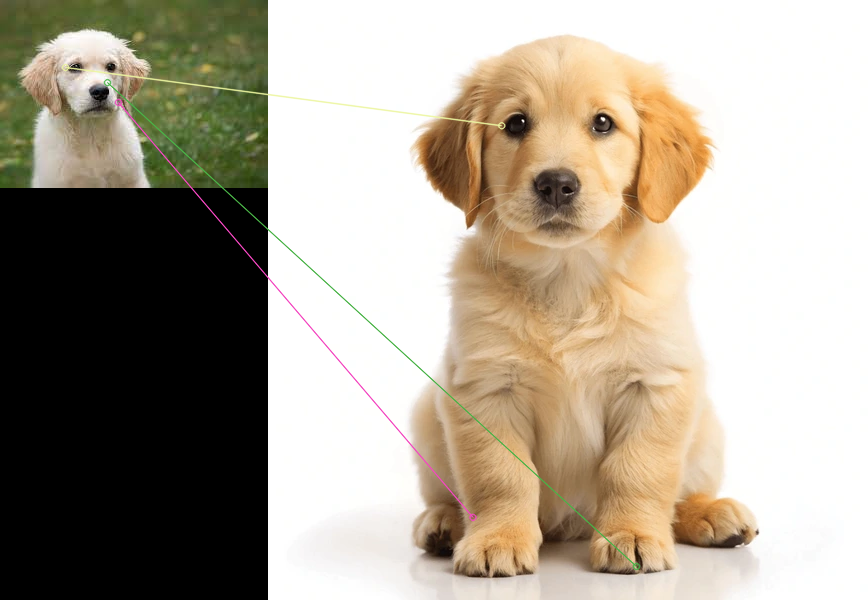

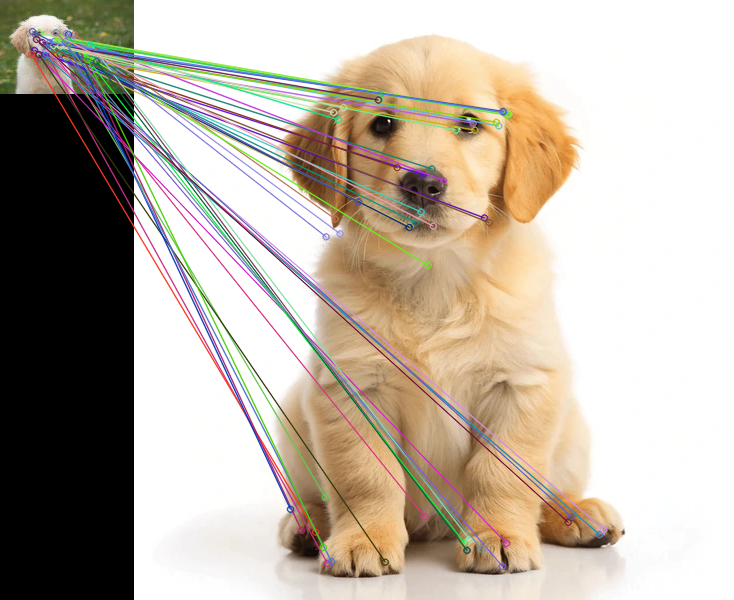

matches - rotation test


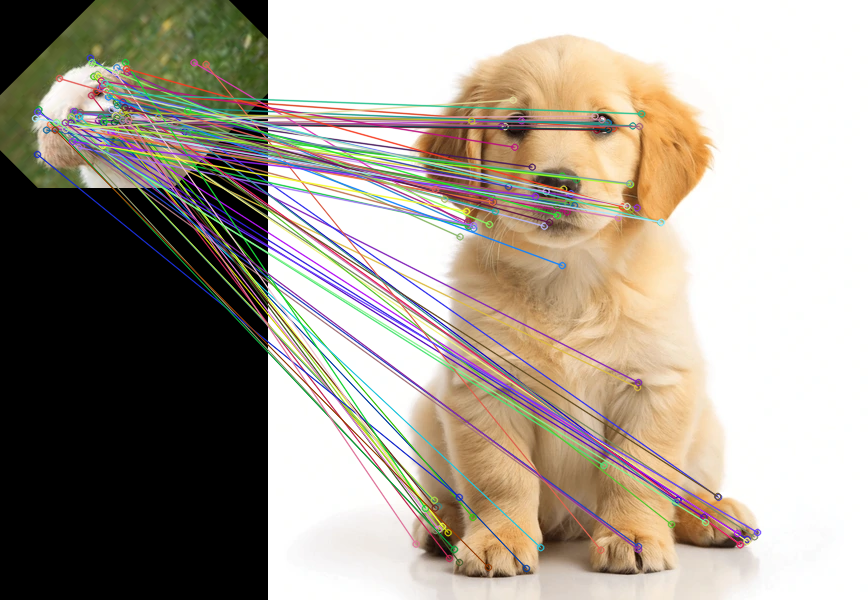

ValueError: all the input array dimensions except for the concatenation axis must match exactly, but along dimension 0, the array at index 0 has size 188 and the array at index 1 has size 600

In [21]:
import cv2
import numpy as np

img1 = cv2.imread('/content/dog1.jpeg')
img2 = cv2.imread('/content/dog2.webp')

gray1 = cv2.cvtColor(img1, cv2.COLOR_BGR2GRAY)
gray2 = cv2.cvtColor(img2, cv2.COLOR_BGR2GRAY)

orb = cv2.ORB_create(nfeatures=1000)

kp1, des1 = orb.detectAndCompute(gray1, None)
kp2, des2 = orb.detectAndCompute(gray2, None)

img1_keypoints = cv2.drawKeypoints(img1, kp1, None, color=(0, 255, 0), flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
img2_keypoints = cv2.drawKeypoints(img2, kp2, None, color=(0, 255, 0), flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)

cv2_imshow(img1_keypoints)
cv2_imshow(img2_keypoints)
cv2.waitKey(0)
cv2.destroyAllWindows()

bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True)

matches = bf.match(des1, des2)

matches = sorted(matches, key=lambda x: x.distance)

img_matches = cv2.drawMatches(img1, kp1, img2, kp2, matches[:100], None, flags=cv2.DRAW_MATCHES_FLAGS_NOT_DRAW_SINGLE_POINTS)

cv2_imshow(img_matches)
cv2.waitKey(0)
cv2.destroyAllWindows()

FLANN_INDEX_LSH = 6
index_params = dict(algorithm=FLANN_INDEX_LSH, table_number=6, key_size=12, multi_probe_level=1)
search_params = dict(checks=50)

flann = cv2.FlannBasedMatcher(index_params, search_params)

matches_flann = flann.knnMatch(des1, des2, k=2)

good_matches = []
for m_n in matches_flann:
    if len(m_n) == 2:
        m, n = m_n
        if m.distance < 0.7 * n.distance:
            good_matches.append(m)

img_matches_flann = cv2.drawMatches(img1, kp1, img2, kp2, good_matches, None, flags=cv2.DRAW_MATCHES_FLAGS_NOT_DRAW_SINGLE_POINTS)

print('FLANN Matches')
cv2_imshow(img_matches_flann)
cv2.waitKey(0)
cv2.destroyAllWindows()

img1_resized = cv2.resize(img1, (img1.shape[1]//2, img1.shape[0]//2))
gray1_resized = cv2.cvtColor(img1_resized, cv2.COLOR_BGR2GRAY)

kp1_resized, des1_resized = orb.detectAndCompute(gray1_resized, None)

matches_scale = bf.match(des1_resized, des2)
matches_scale = sorted(matches_scale, key=lambda x: x.distance)

img_matches_scale = cv2.drawMatches(img1_resized, kp1_resized, img2, kp2, matches_scale[:100], None, flags=cv2.DRAW_MATCHES_FLAGS_NOT_DRAW_SINGLE_POINTS)

cv2_imshow(img_matches_scale)
cv2.waitKey(0)
cv2.destroyAllWindows()

rows, cols = img1.shape[:2]
M = cv2.getRotationMatrix2D((cols/2, rows/2), 45, 1)
img1_rotated = cv2.warpAffine(img1, M, (cols, rows))
gray1_rotated = cv2.cvtColor(img1_rotated, cv2.COLOR_BGR2GRAY)

kp1_rotated, des1_rotated = orb.detectAndCompute(gray1_rotated, None)

matches_rotation = bf.match(des1_rotated, des2)
matches_rotation = sorted(matches_rotation, key=lambda x: x.distance)

img_matches_rotation = cv2.drawMatches(img1_rotated, kp1_rotated, img2, kp2, matches_rotation[:100], None, flags=cv2.DRAW_MATCHES_FLAGS_NOT_DRAW_SINGLE_POINTS)

print("matches - rotation test")
cv2_imshow(img_matches_rotation)
cv2.waitKey(0)
cv2.destroyAllWindows()

horizontal = np.hstack((img1, img2))
cv2_imshow(horizontal)
cv2.waitKey(0)
cv2.destroyAllWindows()

print(f"Number of keypoints in Image 1: {len(kp1)}")
print(f"Number of keypoints in Image 2: {len(kp2)}")
print(f"Number of matches found (Brute Force): {len(matches)}")
print(f"Number of good matches found (FLANN): {len(good_matches)}")
print(f"Number of matches with scaling: {len(matches_scale)}")
print(f"Number of matches with rotation: {len(matches_rotation)}")